In [1]:
import numpy as np
from scipy.io.wavfile import write
from pylab import*
from scipy.io import wavfile
%pylab inline
from IPython.display import Audio
import wave
import pyaudio 
import librosa

Populating the interactive namespace from numpy and matplotlib


/Users/ianlee/anaconda3/lib/python3.6/site-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['random', 'info', 'fft', 'linalg', 'power']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [2]:
# matplotlib for displaying the output
import matplotlib.pyplot as plt
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib inline

# and IPython.display for audio output
import IPython.display

In [3]:
import librosa.display

In [12]:
import tqdm
def griffinlim(spectrogram, n_iter = 100, window = 'hann', n_fft = 2048, hop_length = -1, verbose = False):
    
    if hop_length == -1:
        hop_length = n_fft // 4

    angles = np.exp(2j * np.pi * np.random.rand(*spectrogram.shape))

    t = tqdm.tqdm(range(n_iter), ncols=100, mininterval=2.0, disable=not verbose)
    
    for i in t:
        
        print ('Iter:' , i , ', Spectrogram Shape:', spectrogram.shape)
        print ('Iter:' , i , ', Angles Shape:', angles.shape)

        full = np.abs(spectrogram).astype(np.complex) * angles
        inverse = librosa.istft(full, hop_length = hop_length, window = window)
        rebuilt = librosa.stft(inverse, n_fft = n_fft, hop_length = hop_length, window = window)
        angles = np.exp(1j * np.angle(rebuilt))

        if verbose:
            diff = np.abs(spectrogram) - np.abs(rebuilt)
            t.set_postfix(loss=np.linalg.norm(diff, 'fro'))

    full = np.abs(spectrogram).astype(np.complex) * angles
    inverse = librosa.istft(full, hop_length = hop_length, window = window)

    return inverse

Length in time (s):  120.0


/Users/ianlee/anaconda3/lib/python3.6/site-packages/librosa/core/spectrum.py:958: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(magphase(D)[0]) instead.
  warnings.warn('amplitude_to_db was called on complex input so phase '


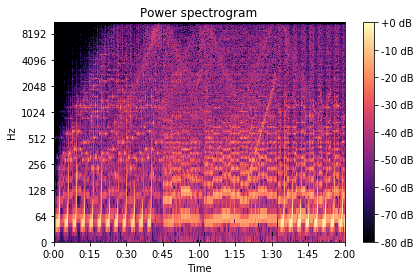

In [4]:
audio_path = 'shivers.wav'

y, sr = librosa.load(audio_path)
if np.shape(y)[0]/float(sr) > 120:
    y = y[0:sr*120] 
print('Length in time (s): ', np.shape(y)[0]/float(sr))


D = librosa.stft(y)

librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max), y_axis='log', x_axis='time')
plt.title('Power spectrogram')
plt.colorbar(format='%+2.0f dB')
plt.tight_layout()

Length in time (s):  120.0


/Users/ianlee/anaconda3/lib/python3.6/site-packages/librosa/core/spectrum.py:958: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(magphase(D)[0]) instead.
  warnings.warn('amplitude_to_db was called on complex input so phase '


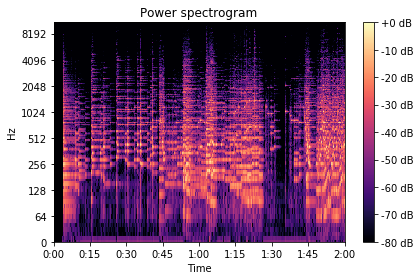

In [5]:
audio_path_p = 'pathetique.wav'

y_p, sr_p = librosa.load(audio_path_p)
if np.shape(y_p)[0]/float(sr_p) > 120:
    y_p = y_p[0:sr_p*120] 
print('Length in time (s): ', np.shape(y_p)[0]/float(sr_p))


D_p = librosa.stft(y_p)

librosa.display.specshow(librosa.amplitude_to_db(D_p, ref=np.max), y_axis='log', x_axis='time')
plt.title('Power spectrogram')
plt.colorbar(format='%+2.0f dB')
plt.tight_layout()

In [6]:
import scipy.misc
scipy.misc.imsave('pathetique_spec.jpg', librosa.amplitude_to_db(D_p, ref=np.max))
scipy.misc.imsave('shivers_spec.jpg', librosa.amplitude_to_db(D, ref=np.max))

/Users/ianlee/anaconda3/lib/python3.6/site-packages/librosa/core/spectrum.py:958: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(magphase(D)[0]) instead.
  warnings.warn('amplitude_to_db was called on complex input so phase '
/Users/ianlee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  
/Users/ianlee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `imsave` is deprecated!
`imsave` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imwrite`` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


In [15]:
transferred = scipy.misc.imread('transferred.jpg')

/Users/ianlee/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.
  """Entry point for launching an IPython kernel.


/Users/ianlee/anaconda3/lib/python3.6/site-packages/tqdm/_monitor.py:89: TqdmSynchronisationWarning: Set changed size during iteration (see https://github.com/tqdm/tqdm/issues/481)
  TqdmSynchronisationWarning)


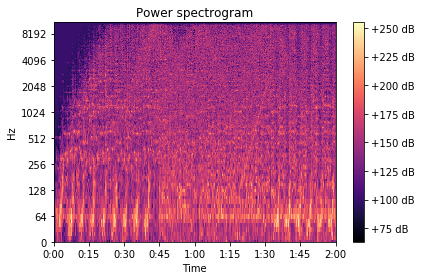

In [16]:
librosa.display.specshow(transferred[:,:,0], y_axis='log', x_axis='time')
plt.title('Power spectrogram')
plt.colorbar(format='%+2.0f dB')
plt.tight_layout()

In [17]:
spec_to_wav_simple_t = griffinlim(librosa.db_to_amplitude(transferred[:,:,0]))
IPython.display.Audio(data=spec_to_wav_simple_t, rate=sr_p)

Iter: 0 , Spectrogram Shape: (1025, 5168)
Iter: 0 , Angles Shape: (1025, 5168)
Iter: 1 , Spectrogram Shape: (1025, 5168)
Iter: 1 , Angles Shape: (1025, 5168)
Iter: 2 , Spectrogram Shape: (1025, 5168)
Iter: 2 , Angles Shape: (1025, 5168)
Iter: 3 , Spectrogram Shape: (1025, 5168)
Iter: 3 , Angles Shape: (1025, 5168)
Iter: 4 , Spectrogram Shape: (1025, 5168)
Iter: 4 , Angles Shape: (1025, 5168)
Iter: 5 , Spectrogram Shape: (1025, 5168)
Iter: 5 , Angles Shape: (1025, 5168)
Iter: 6 , Spectrogram Shape: (1025, 5168)
Iter: 6 , Angles Shape: (1025, 5168)


/Users/ianlee/anaconda3/lib/python3.6/site-packages/tqdm/_monitor.py:89: TqdmSynchronisationWarning: Set changed size during iteration (see https://github.com/tqdm/tqdm/issues/481)
  TqdmSynchronisationWarning)


Iter: 7 , Spectrogram Shape: (1025, 5168)
Iter: 7 , Angles Shape: (1025, 5168)
Iter: 8 , Spectrogram Shape: (1025, 5168)
Iter: 8 , Angles Shape: (1025, 5168)
Iter: 9 , Spectrogram Shape: (1025, 5168)
Iter: 9 , Angles Shape: (1025, 5168)
Iter: 10 , Spectrogram Shape: (1025, 5168)
Iter: 10 , Angles Shape: (1025, 5168)
Iter: 11 , Spectrogram Shape: (1025, 5168)
Iter: 11 , Angles Shape: (1025, 5168)
Iter: 12 , Spectrogram Shape: (1025, 5168)
Iter: 12 , Angles Shape: (1025, 5168)
Iter: 13 , Spectrogram Shape: (1025, 5168)
Iter: 13 , Angles Shape: (1025, 5168)
Iter: 14 , Spectrogram Shape: (1025, 5168)
Iter: 14 , Angles Shape: (1025, 5168)
Iter: 15 , Spectrogram Shape: (1025, 5168)
Iter: 15 , Angles Shape: (1025, 5168)
Iter: 16 , Spectrogram Shape: (1025, 5168)
Iter: 16 , Angles Shape: (1025, 5168)
Iter: 17 , Spectrogram Shape: (1025, 5168)
Iter: 17 , Angles Shape: (1025, 5168)
Iter: 18 , Spectrogram Shape: (1025, 5168)
Iter: 18 , Angles Shape: (1025, 5168)
Iter: 19 , Spectrogram Shape: (102

In [25]:
from sklearn.preprocessing import normalize

In [27]:
normalized = spec_to_wav_simple_t/ np.max(spec_to_wav_simple_t)

/Users/ianlee/anaconda3/lib/python3.6/site-packages/tqdm/_monitor.py:89: TqdmSynchronisationWarning: Set changed size during iteration (see https://github.com/tqdm/tqdm/issues/481)
  TqdmSynchronisationWarning)


In [28]:
IPython.display.Audio(data=normalized, rate=sr_p)

/Users/ianlee/anaconda3/lib/python3.6/site-packages/tqdm/_monitor.py:89: TqdmSynchronisationWarning: Set changed size during iteration (see https://github.com/tqdm/tqdm/issues/481)
  TqdmSynchronisationWarning)


In [21]:
IPython.display.Audio(data=y, rate=sr_p)

/Users/ianlee/anaconda3/lib/python3.6/site-packages/tqdm/_monitor.py:89: TqdmSynchronisationWarning: Set changed size during iteration (see https://github.com/tqdm/tqdm/issues/481)
  TqdmSynchronisationWarning)
